### Importing Necessary Packages

In [1]:
from functools import cmp_to_key
from tslearn.clustering import silhouette_score, TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import pickle
import re

### Defining Important Constants

In [2]:
DATA_FOLDER = '/home/faranio/Desktop/EDISS/Courses/1st Year. Period 1/Data Intensive Engineering I/Brain-Neuroactivity/data/'
VIDEOS_FOLDER = os.path.join(DATA_FOLDER, '02_converted')
GRAPHS_FOLDER = os.path.join(DATA_FOLDER, '08_graphs')
DATASET_FOLDER = os.path.join(DATA_FOLDER, '11_dataset')
DATASET_PATH = os.path.join(DATASET_FOLDER, 'dataset.pickle')

FEATURES_AND_CLUSTER_NUMS = {
    'Lower_Body_To_Body_Distance_12': 2,
    'Mean_Body_Position_Distance_12': 2,
    'Nose_To_Nose_Distance_12': 2,
    'Nose_To_Body_Distance_12': 2,
    'Nose_To_Back_Distance_12': 2,
    'Nose_To_Tail_End_Distance_12': 2
}

### Defining Video Name Sorting

In [3]:
def compare(a, b):
    if a > b:
        return 1
    elif a < b:
        return -1
    
    return None

def video_name_sort(a, b):
    regex = r'\d+'
    a_nums, b_nums = re.findall(regex, a['Video']), re.findall(regex, b['Video'])
    
    for i, j in zip(a_nums, b_nums):
        if int(i) > int(j):
            return 1
        if int(i) < int(j):
            return -1
        
    return 0

### Reading the Social Interaction Dataset

In [4]:
def read_dataset():
    first_exp_dataset = []
    second_exp_dataset = []
    video_idx_to_name = {}
    
    with open(DATASET_PATH, 'rb') as file:
        dataset = pickle.load(file)
        
    dataset = sorted(dataset, key=cmp_to_key(video_name_sort))
    
    for i in range(len(dataset)):
        if '_v3_' in dataset[i]['Video']:
            second_exp_dataset.append(dataset[i])
        else:
            first_exp_dataset.append(dataset[i])
            
        video_idx_to_name[i] = dataset[i]['Video']
    
    return first_exp_dataset, second_exp_dataset, video_idx_to_name

first_dataset, second_dataset, video_idx_to_name = read_dataset()

### Performing the Cumulative Time Series KMeans Clustering

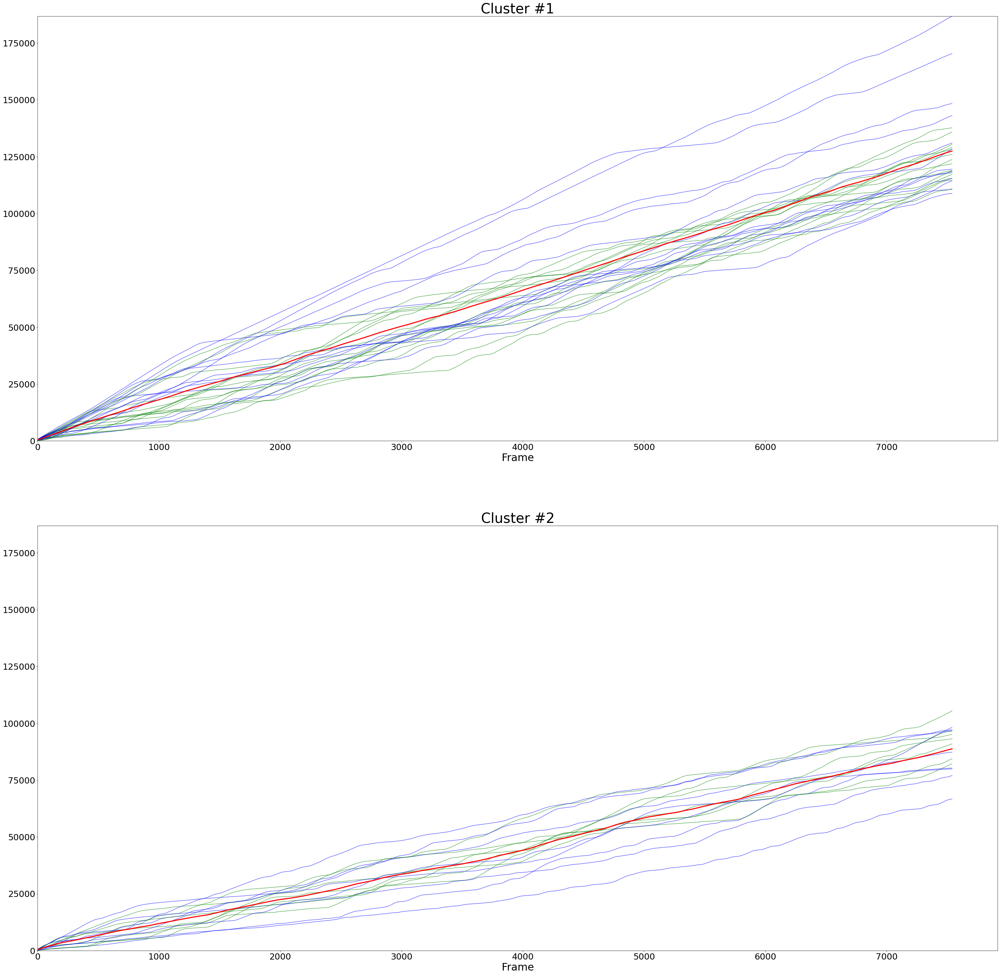

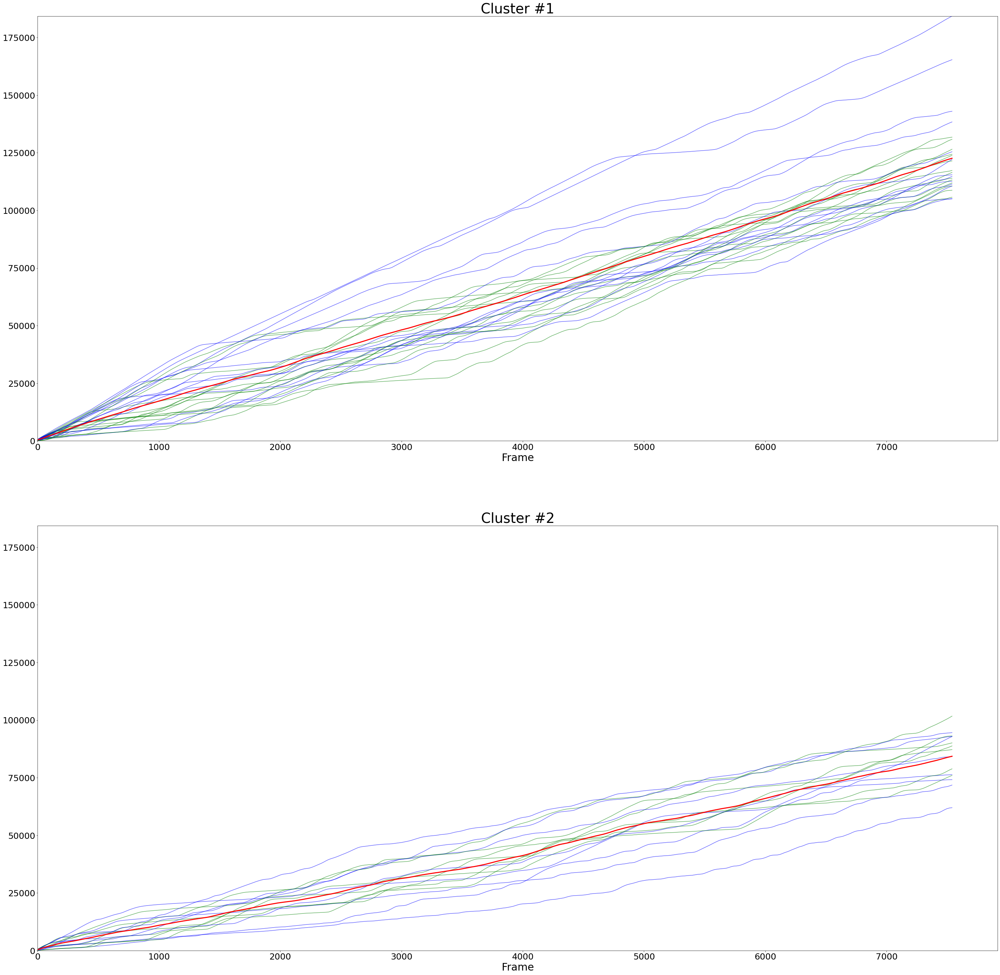

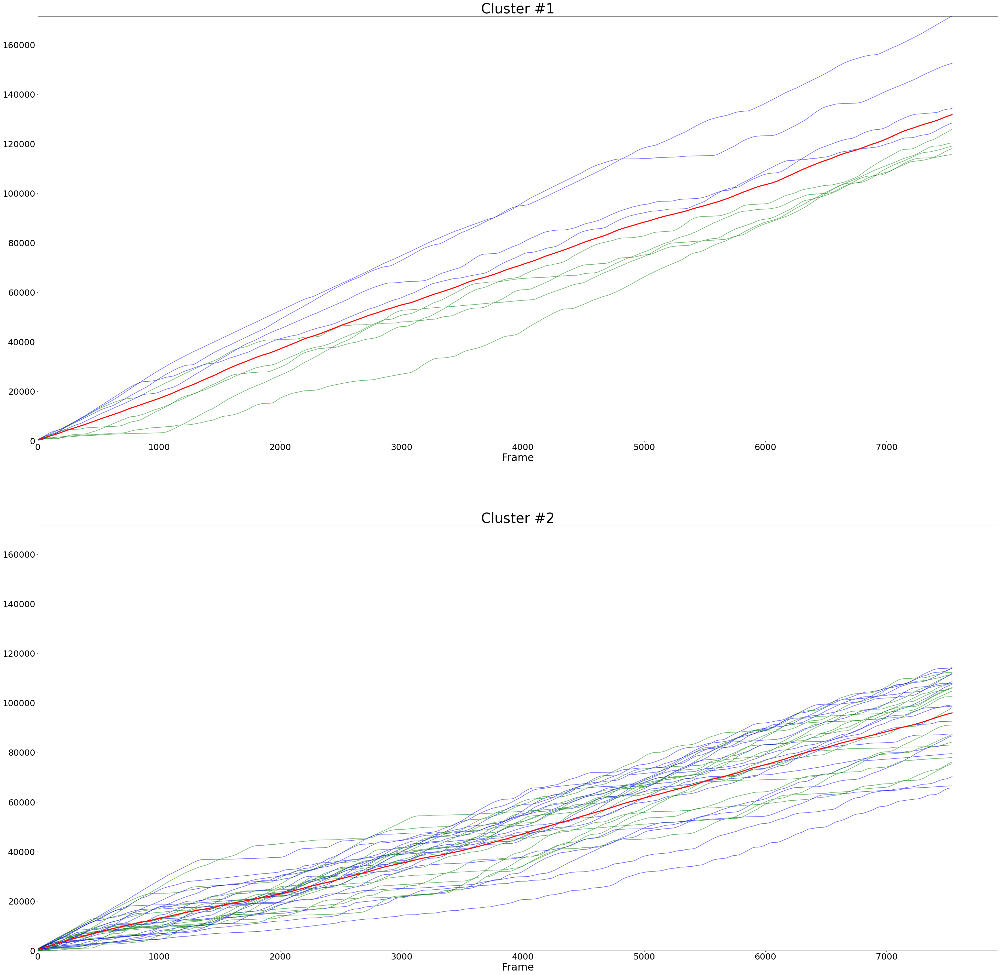

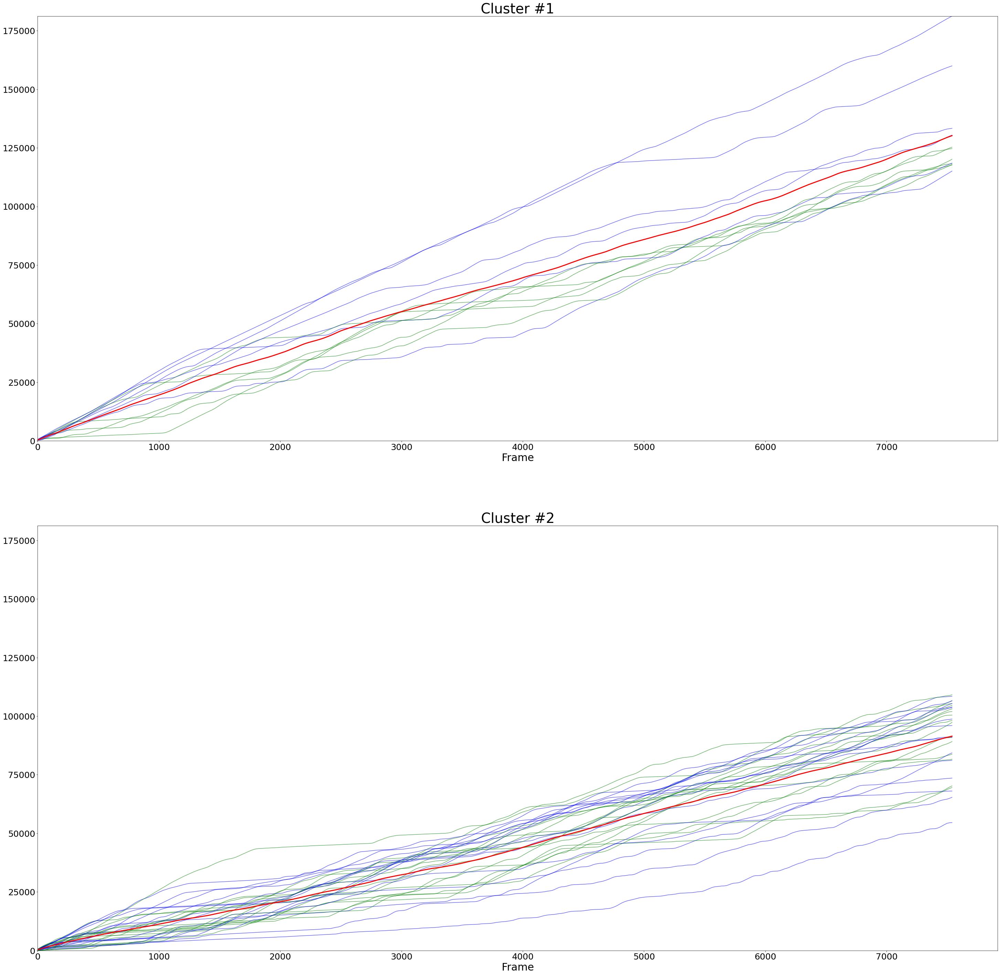

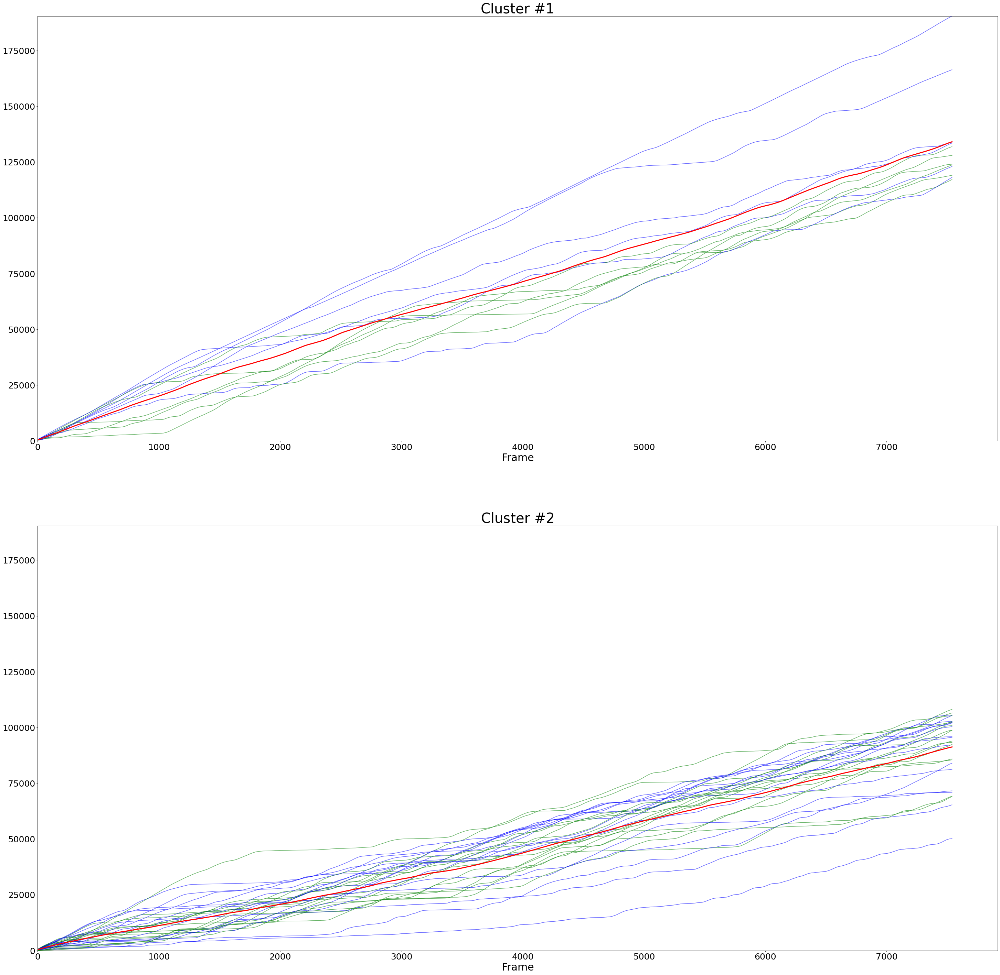

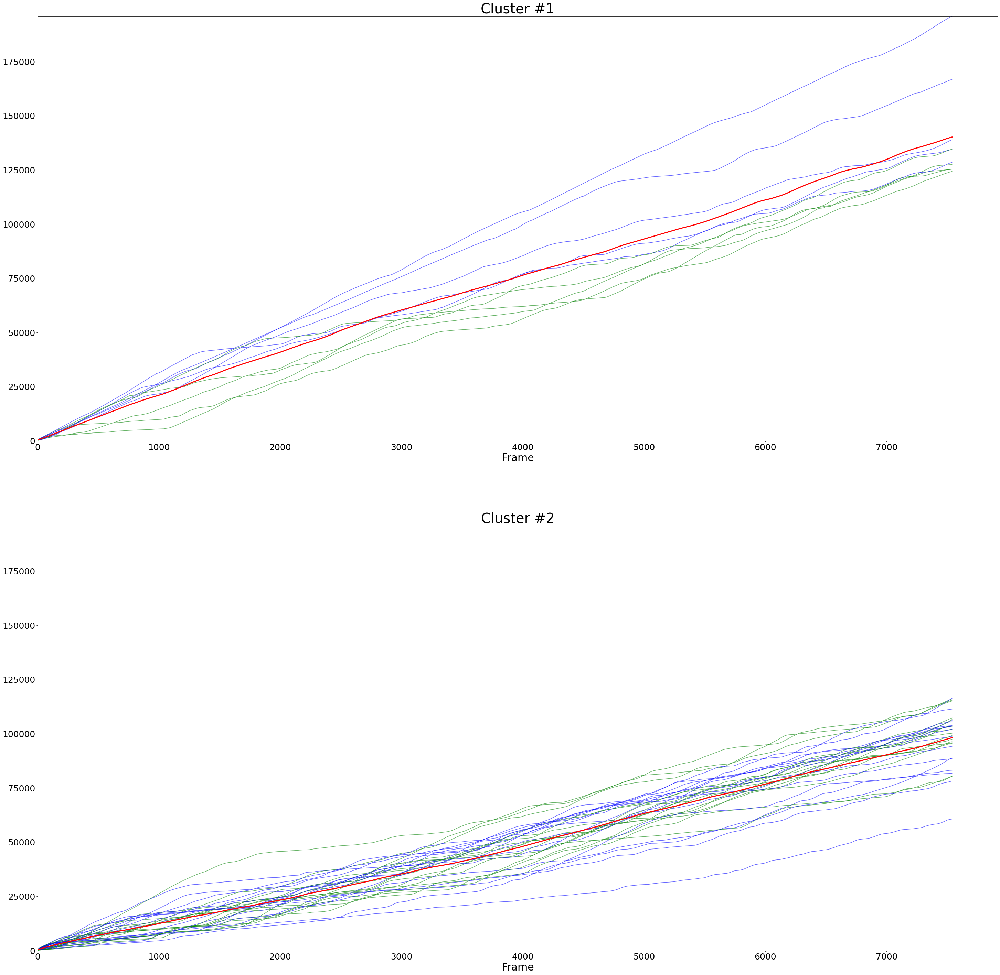

In [8]:
STEP = 20
graph_folder = os.path.join(GRAPHS_FOLDER, 'Clusters', 'Cumulative')

for main_feature, n_clusters in FEATURES_AND_CLUSTER_NUMS.items():
    X = []
    videos = {}
    colors = []
    seed = 0

    for i in range(len(second_dataset)):
        X.append(second_dataset[i]['Data'][main_feature][1:].cumsum())
        videos[i] = second_dataset[i]['Video']
        
        if 'treatment' in videos[i]:
            colors.append('blue')
        else:
            colors.append('green')

    X = pd.concat(X, axis=1).transpose().fillna(method='bfill')
    X = X.values[:, :, np.newaxis]

    clusterer = TimeSeriesKMeans(
        n_clusters=n_clusters,
        metric="dtw",
        random_state=seed,
        n_jobs=-1
    )
    y_pred = clusterer.fit_predict(X)
    
    fig, ax = plt.subplots(n_clusters, 1, figsize=(50, 50), facecolor='white')
    
    for yi in range(n_clusters):
        for i in range(len(X)):
            if y_pred[i] == yi:
                temp = pd.DataFrame(X[i].ravel())
                temp.index = pd.RangeIndex(0, X.shape[1] * STEP, step=STEP)
                ax[yi].plot(temp.index, temp[0], "k-", alpha=0.6, c=colors[i])
#             ax[yi].plot(clusterer.cluster_centers_[yi].ravel(), "r-", linewidth=3)
                
        temp = pd.DataFrame(np.mean(X[y_pred == yi], axis=0).ravel())
        temp.index = pd.RangeIndex(0, X.shape[1] * STEP, step=STEP)
        ax[yi].plot(temp.index, temp[0], "r-", linewidth=3)
        ax[yi].set_xlim(0)
        ax[yi].set_ylim(0, np.max(X))
        ax[yi].set_xlabel('Frame', fontsize=30)
        ax[yi].set_title(f"Cluster #{yi+1}", fontsize=40)
        ax[yi].tick_params(axis='both', which='major', labelsize=25)
    
    plt.savefig(f'{graph_folder}/{main_feature}_second_dataset_by_experiment.png', facecolor=fig.get_facecolor(), edgecolor='none')
    plt.show()

#     dtw_score = silhouette_score(X, clusterer.labels_, metric='dtw')

#     print('*' * 70)
#     print(f"\n[FEATURE]            ---> {main_feature}")
#     print(f"[NUMBER OF CLUSTERS] ---> {n_clusters}")
#     print(f"[SILHOUETTE SCORE]   ---> {dtw_score}")

#     unique_labels = np.unique(clusterer.labels_)
#     video_mapping = {label: [] for label in unique_labels}

#     for i in range(len(videos)):
#         video_mapping[clusterer.labels_[i]].append(i)

#     for label, videos_list in video_mapping.items():
#         print(f"\nCluster #{label}:")

#         for i in videos_list:
#             print(f"- {videos[i]}")

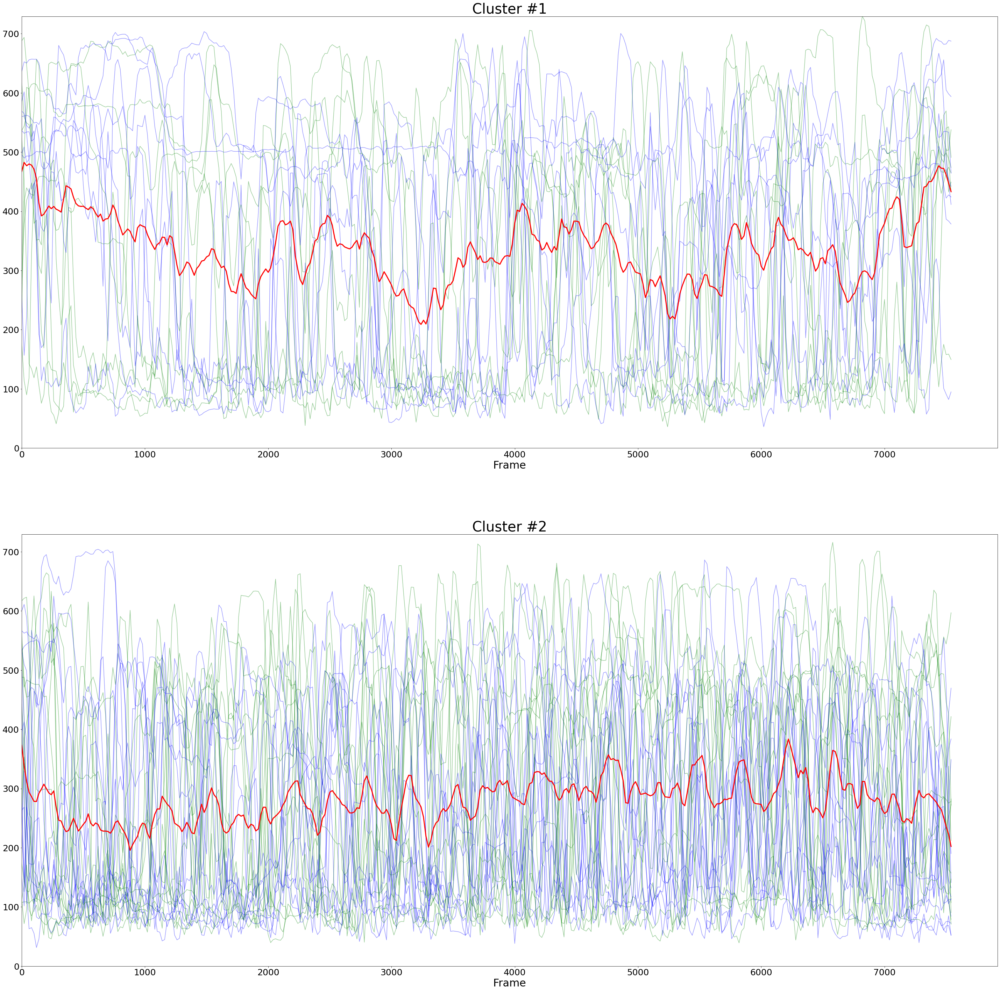

**********************************************************************

[FEATURE]            ---> Lower_Body_To_Body_Distance_12
[NUMBER OF CLUSTERS] ---> 2
[SILHOUETTE SCORE]   ---> 0.1538321062609284

Cluster #0:
- Trial_1_v3_SI_w2_control_2168.mp4
- Trial_1_v3_SI_w6_control_2168.mp4
- Trial_2_v3_SI_w2_treatment_333.mp4
- Trial_5_v3_SI_w2_treatment_3706.mp4
- Trial_6_v3_SI_w2_control_2368.mp4
- Trial_7_v3_SI_w6_control_1051.mp4
- Trial_11_v3_SI_w2_control_6521.mp4
- Trial_11_v3_SI_w6_control_2384.mp4
- Trial_12_v3_SI_w6_treatment_3274.mp4
- Trial_16_v3_SI_w6_treatment_1401.mp4
- Trial_18_v3_SI_w2_treatment_1401.mp4
- Trial_18_v3_SI_w6_treatment_880.mp4
- Trial_19_v3_SI_w2_control_2614.mp4
- Trial_20_v3_SI_w2_treatment_880.mp4
- Trial_21_v3_SI_w2_control_5423.mp4
- Trial_22_v3_SI_w2_treatment_29242.mp4

Cluster #1:
- Trial_2_v3_SI_w6_treatment_333.mp4
- Trial_3_v3_SI_w2_control_2686.mp4
- Trial_3_v3_SI_w6_control_2686.mp4
- Trial_4_v3_SI_w2_treatment_5434.mp4
- Trial_4_v3_SI_w6_treatm

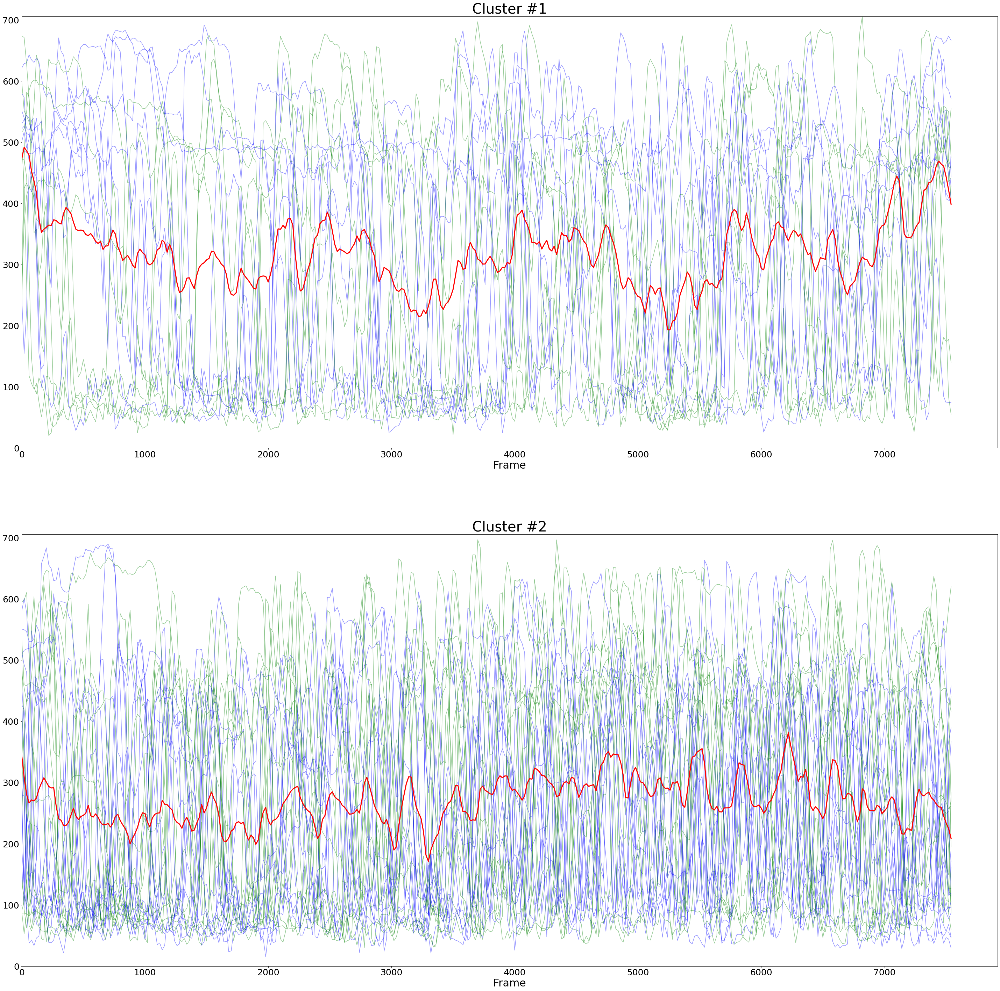

**********************************************************************

[FEATURE]            ---> Mean_Body_Position_Distance_12
[NUMBER OF CLUSTERS] ---> 2
[SILHOUETTE SCORE]   ---> 0.13409032892912967

Cluster #0:
- Trial_1_v3_SI_w2_control_2168.mp4
- Trial_1_v3_SI_w6_control_2168.mp4
- Trial_2_v3_SI_w2_treatment_333.mp4
- Trial_5_v3_SI_w2_treatment_3706.mp4
- Trial_6_v3_SI_w2_control_2368.mp4
- Trial_6_v3_SI_w6_control_2368.mp4
- Trial_7_v3_SI_w6_control_1051.mp4
- Trial_11_v3_SI_w2_control_6521.mp4
- Trial_11_v3_SI_w6_control_2384.mp4
- Trial_12_v3_SI_w6_treatment_3274.mp4
- Trial_16_v3_SI_w6_treatment_1401.mp4
- Trial_18_v3_SI_w2_treatment_1401.mp4
- Trial_18_v3_SI_w6_treatment_880.mp4
- Trial_20_v3_SI_w2_treatment_880.mp4
- Trial_21_v3_SI_w2_control_5423.mp4
- Trial_22_v3_SI_w2_treatment_29242.mp4

Cluster #1:
- Trial_2_v3_SI_w6_treatment_333.mp4
- Trial_3_v3_SI_w2_control_2686.mp4
- Trial_3_v3_SI_w6_control_2686.mp4
- Trial_4_v3_SI_w2_treatment_5434.mp4
- Trial_4_v3_SI_w6_treatm

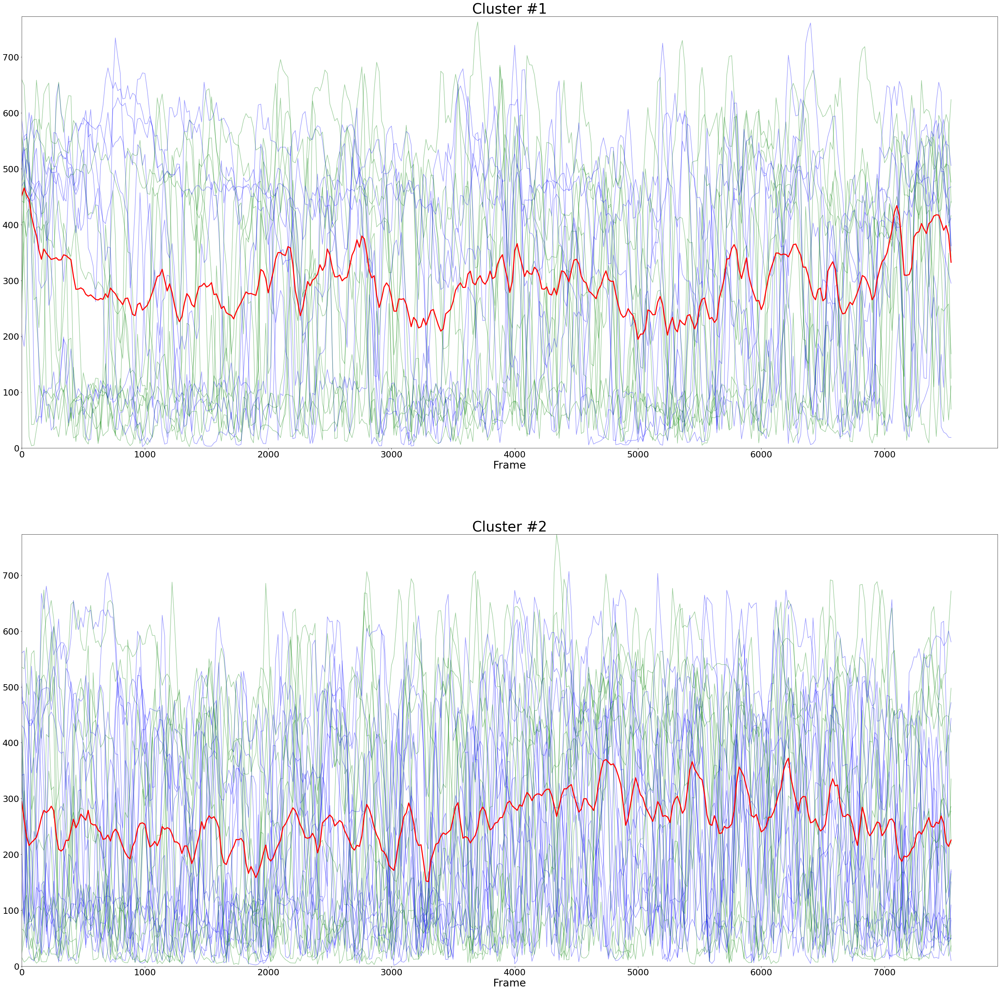

**********************************************************************

[FEATURE]            ---> Nose_To_Nose_Distance_12
[NUMBER OF CLUSTERS] ---> 2
[SILHOUETTE SCORE]   ---> 0.098777589443654

Cluster #0:
- Trial_1_v3_SI_w2_control_2168.mp4
- Trial_1_v3_SI_w6_control_2168.mp4
- Trial_2_v3_SI_w2_treatment_333.mp4
- Trial_3_v3_SI_w2_control_2686.mp4
- Trial_5_v3_SI_w2_treatment_3706.mp4
- Trial_6_v3_SI_w2_control_2368.mp4
- Trial_6_v3_SI_w6_control_2368.mp4
- Trial_7_v3_SI_w6_control_1051.mp4
- Trial_9_v3_SI_w6_control_6521.mp4
- Trial_10_v3_SI_w6_treatment_1010.mp4
- Trial_11_v3_SI_w2_control_6521.mp4
- Trial_11_v3_SI_w6_control_2384.mp4
- Trial_12_v3_SI_w6_treatment_3274.mp4
- Trial_16_v3_SI_w6_treatment_1401.mp4
- Trial_18_v3_SI_w6_treatment_880.mp4
- Trial_20_v3_SI_w2_treatment_880.mp4
- Trial_21_v3_SI_w2_control_5423.mp4
- Trial_22_v3_SI_w2_treatment_29242.mp4

Cluster #1:
- Trial_2_v3_SI_w6_treatment_333.mp4
- Trial_3_v3_SI_w6_control_2686.mp4
- Trial_4_v3_SI_w2_treatment_5434.m

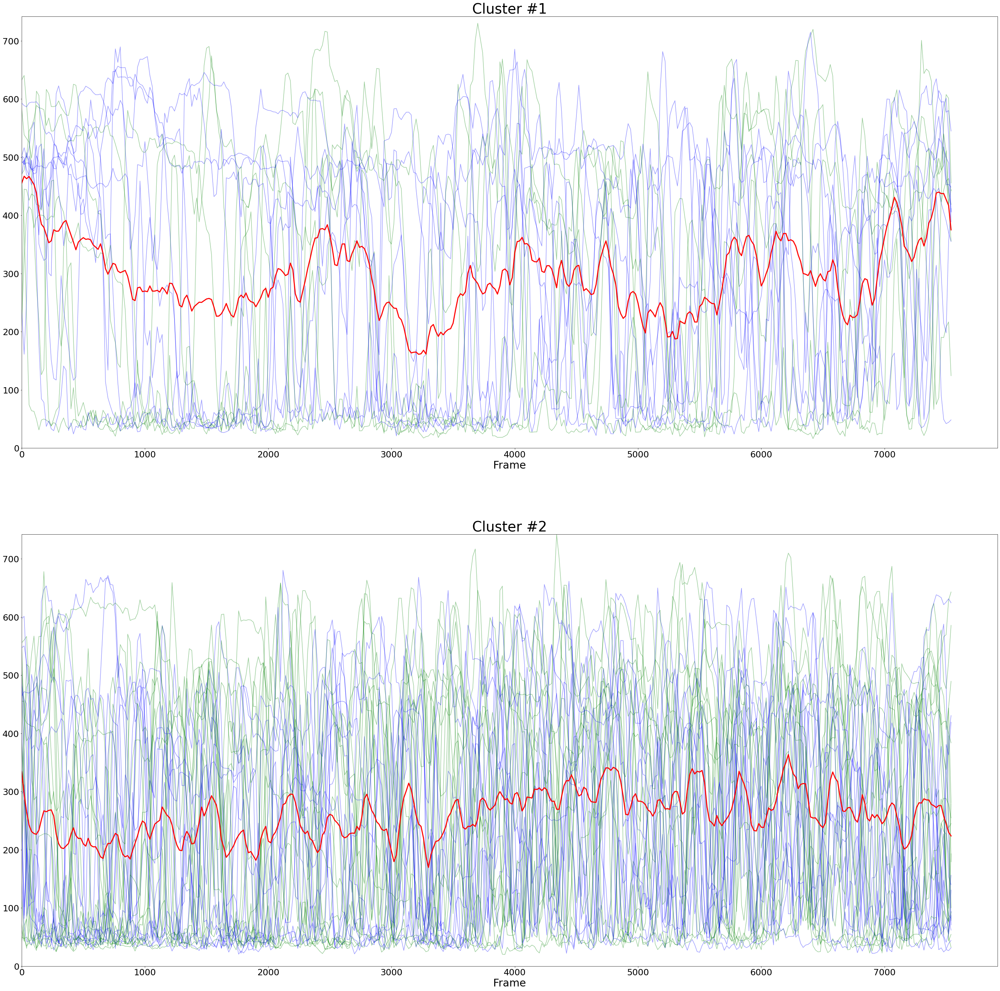

**********************************************************************

[FEATURE]            ---> Nose_To_Body_Distance_12
[NUMBER OF CLUSTERS] ---> 2
[SILHOUETTE SCORE]   ---> 0.1337648066323877

Cluster #0:
- Trial_1_v3_SI_w2_control_2168.mp4
- Trial_1_v3_SI_w6_control_2168.mp4
- Trial_2_v3_SI_w2_treatment_333.mp4
- Trial_5_v3_SI_w2_treatment_3706.mp4
- Trial_6_v3_SI_w2_control_2368.mp4
- Trial_7_v3_SI_w2_treatment_5906.mp4
- Trial_7_v3_SI_w6_control_1051.mp4
- Trial_11_v3_SI_w6_control_2384.mp4
- Trial_12_v3_SI_w6_treatment_3274.mp4
- Trial_16_v3_SI_w6_treatment_1401.mp4
- Trial_18_v3_SI_w6_treatment_880.mp4
- Trial_20_v3_SI_w2_treatment_880.mp4
- Trial_21_v3_SI_w2_control_5423.mp4
- Trial_22_v3_SI_w2_treatment_29242.mp4

Cluster #1:
- Trial_2_v3_SI_w6_treatment_333.mp4
- Trial_3_v3_SI_w2_control_2686.mp4
- Trial_3_v3_SI_w6_control_2686.mp4
- Trial_4_v3_SI_w2_treatment_5434.mp4
- Trial_4_v3_SI_w6_treatment_5434.mp4
- Trial_5_v3_SI_w6_treatment_3706.mp4
- Trial_6_v3_SI_w6_control_236

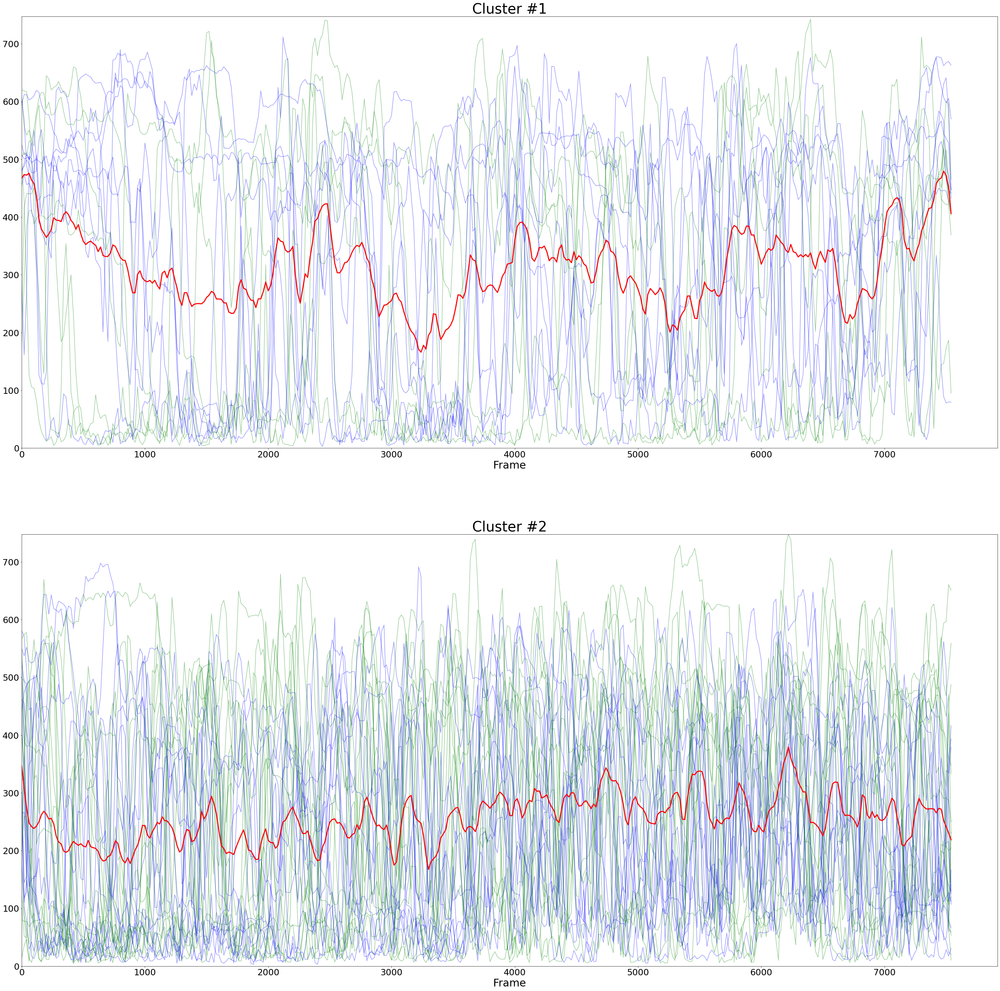

**********************************************************************

[FEATURE]            ---> Nose_To_Back_Distance_12
[NUMBER OF CLUSTERS] ---> 2
[SILHOUETTE SCORE]   ---> 0.15502340280628252

Cluster #0:
- Trial_1_v3_SI_w2_control_2168.mp4
- Trial_1_v3_SI_w6_control_2168.mp4
- Trial_2_v3_SI_w2_treatment_333.mp4
- Trial_5_v3_SI_w2_treatment_3706.mp4
- Trial_6_v3_SI_w2_control_2368.mp4
- Trial_7_v3_SI_w6_control_1051.mp4
- Trial_11_v3_SI_w6_control_2384.mp4
- Trial_12_v3_SI_w6_treatment_3274.mp4
- Trial_16_v3_SI_w6_treatment_1401.mp4
- Trial_18_v3_SI_w2_treatment_1401.mp4
- Trial_18_v3_SI_w6_treatment_880.mp4
- Trial_20_v3_SI_w2_treatment_880.mp4
- Trial_21_v3_SI_w2_control_5423.mp4
- Trial_22_v3_SI_w2_treatment_29242.mp4

Cluster #1:
- Trial_2_v3_SI_w6_treatment_333.mp4
- Trial_3_v3_SI_w2_control_2686.mp4
- Trial_3_v3_SI_w6_control_2686.mp4
- Trial_4_v3_SI_w2_treatment_5434.mp4
- Trial_4_v3_SI_w6_treatment_5434.mp4
- Trial_5_v3_SI_w6_treatment_3706.mp4
- Trial_6_v3_SI_w6_control_2

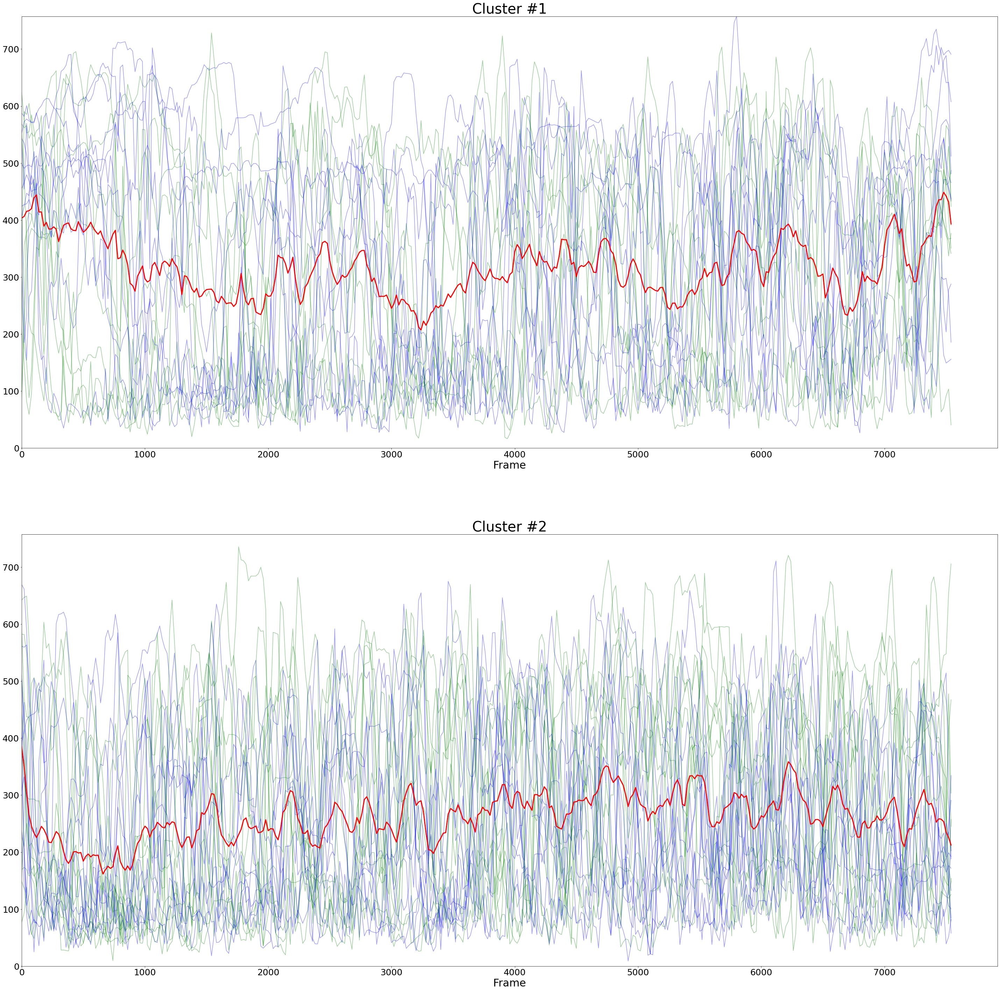

**********************************************************************

[FEATURE]            ---> Nose_To_Tail_End_Distance_12
[NUMBER OF CLUSTERS] ---> 2
[SILHOUETTE SCORE]   ---> 0.12426450980082684

Cluster #0:
- Trial_1_v3_SI_w2_control_2168.mp4
- Trial_1_v3_SI_w6_control_2168.mp4
- Trial_2_v3_SI_w2_treatment_333.mp4
- Trial_5_v3_SI_w2_treatment_3706.mp4
- Trial_5_v3_SI_w6_treatment_3706.mp4
- Trial_6_v3_SI_w2_control_2368.mp4
- Trial_7_v3_SI_w2_treatment_5906.mp4
- Trial_7_v3_SI_w6_control_1051.mp4
- Trial_10_v3_SI_w2_control_5641.mp4
- Trial_11_v3_SI_w2_control_6521.mp4
- Trial_11_v3_SI_w6_control_2384.mp4
- Trial_12_v3_SI_w6_treatment_3274.mp4
- Trial_16_v3_SI_w6_treatment_1401.mp4
- Trial_18_v3_SI_w2_treatment_1401.mp4
- Trial_18_v3_SI_w6_treatment_880.mp4
- Trial_19_v3_SI_w2_control_2614.mp4
- Trial_20_v3_SI_w2_treatment_880.mp4
- Trial_21_v3_SI_w2_control_5423.mp4
- Trial_22_v3_SI_w2_treatment_29242.mp4

Cluster #1:
- Trial_2_v3_SI_w6_treatment_333.mp4
- Trial_3_v3_SI_w2_cont

In [9]:
STEP = 20
graph_folder = os.path.join(GRAPHS_FOLDER, 'Clusters', 'Normalized')

for main_feature, n_clusters in FEATURES_AND_CLUSTER_NUMS.items():
    X = []
    videos = {}
    colors = []
    seed = 0

    for i in range(len(second_dataset)):
        X.append(second_dataset[i]['Data'][main_feature][1:])
        videos[i] = second_dataset[i]['Video']
        
        if 'treatment' in videos[i]:
            colors.append('blue')
        else:
            colors.append('green')

    X = pd.concat(X, axis=1).transpose().fillna(method='bfill')
    X = X.values[:, :, np.newaxis]

    clusterer = TimeSeriesKMeans(
        n_clusters=n_clusters,
        metric="dtw",
        random_state=seed,
        n_jobs=-1
    )
    y_pred = clusterer.fit_predict(X)
    
    fig, ax = plt.subplots(n_clusters, 1, figsize=(50, 50), facecolor='white')
    
    for yi in range(n_clusters):
        for i in range(len(X)):
            if y_pred[i] == yi:
                temp = pd.DataFrame(X[i].ravel())
                temp.index = pd.RangeIndex(0, X.shape[1] * STEP, step=STEP)
                ax[yi].plot(temp.index, temp[0], "k-", alpha=0.4, c=colors[i])
#             ax[yi].plot(clusterer.cluster_centers_[yi].ravel(), "r-", linewidth=3)
                
        temp = pd.DataFrame(np.mean(X[y_pred == yi], axis=0).ravel())
        temp.index = pd.RangeIndex(0, X.shape[1] * STEP, step=STEP)
        ax[yi].plot(temp.index, temp[0], "r-", linewidth=3)
        ax[yi].set_xlim(0)
        ax[yi].set_ylim(0, np.max(X))
        ax[yi].set_xlabel('Frame', fontsize=30)
        ax[yi].set_title(f"Cluster #{yi+1}", fontsize=40)
        ax[yi].tick_params(axis='both', which='major', labelsize=25)
    
    plt.savefig(f'{graph_folder}/{main_feature}_second_dataset_by_experiment.png', facecolor=fig.get_facecolor(), edgecolor='none')
    plt.show()

    dtw_score = silhouette_score(X, clusterer.labels_, metric='dtw')

    print('*' * 70)
    print(f"\n[FEATURE]            ---> {main_feature}")
    print(f"[NUMBER OF CLUSTERS] ---> {n_clusters}")
    print(f"[SILHOUETTE SCORE]   ---> {dtw_score}")

    unique_labels = np.unique(clusterer.labels_)
    video_mapping = {label: [] for label in unique_labels}

    for i in range(len(videos)):
        video_mapping[clusterer.labels_[i]].append(i)

    for label, videos_list in video_mapping.items():
        print(f"\nCluster #{label}:")

        for i in videos_list:
            print(f"- {videos[i]}")

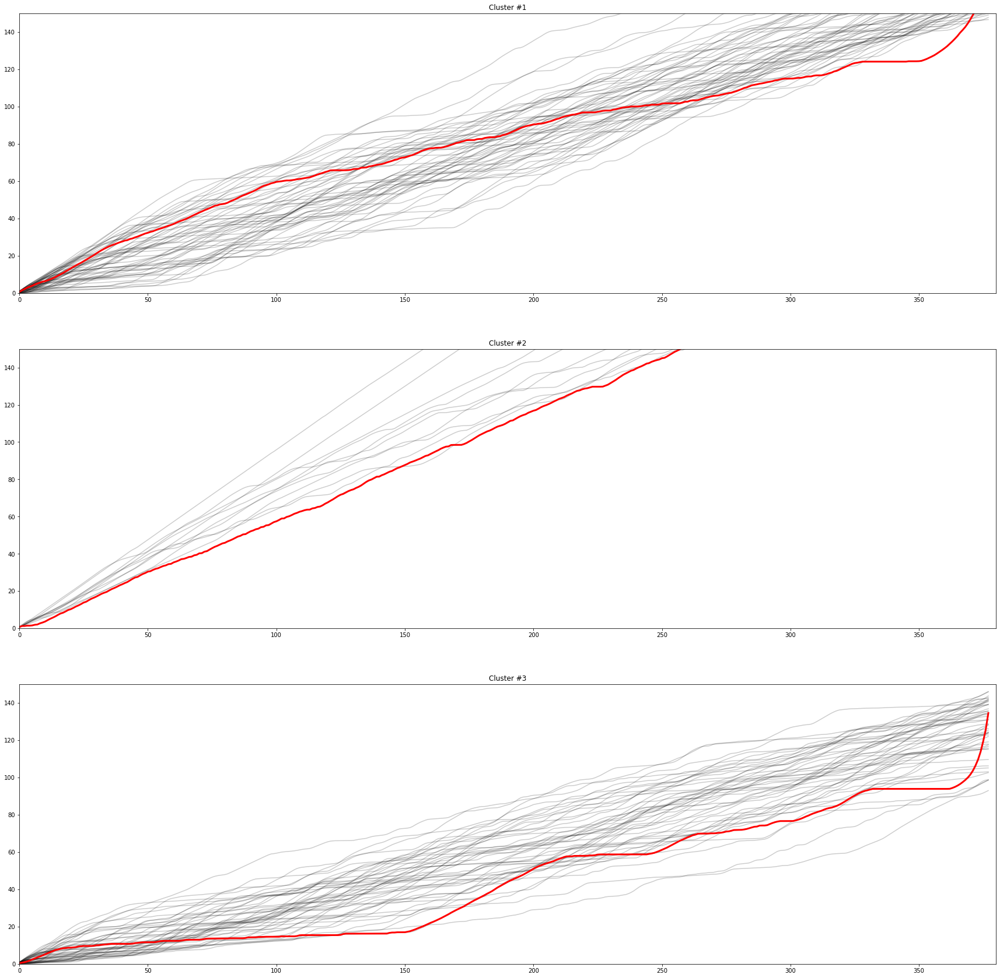

In [14]:
# fig, ax = plt.subplots(n_clusters, 1, figsize=(30, 30))

# for yi in range(n_clusters):    
#     for xx in X[y_pred == yi]:
#         ax[yi].plot(xx.ravel(), "k-", alpha=.2)
        
#     ax[yi].plot(clusterer.cluster_centers_[yi].ravel(), "r-", linewidth=3)
#     ax[yi].set_xlim(0, 380)
#     ax[yi].set_ylim(0, 150)
#     ax[yi].set_title(f"Cluster #{yi+1}")
    
# plt.show()

In [15]:
unique_labels = np.unique(clusterer.labels_)
video_mapping = {label: [] for label in unique_labels}

for i in range(len(videos)):
    video_mapping[clusterer.labels_[i]].append(i)

for label, videos_list in video_mapping.items():
    print(f"\nCluster #{label}:")

    for i in videos_list:
        print(f"- {videos[i]}")


Cluster #0:
- Trial_10_v2_SI_w2_treatment_12358.mp4
- Trial_10_v3_SI_w2_control_5641.mp4
- Trial_10_v3_SI_w6_treatment_1010.mp4
- Trial_11_v2_SI_w2_treatment_2577.mp4
- Trial_11_v2_SI_w6_treatment_2577.mp4
- Trial_11_v3_SI_w2_control_6521.mp4
- Trial_12_v1_SI_w6_control_2018.mp4
- Trial_12_v2_SI_w2_treatment_2184.mp4
- Trial_12_v3_SI_w2_treatment_1010.mp4
- Trial_12_v3_SI_w6_treatment_3274.mp4
- Trial_13_v1_SI_w6_treatment_4281.mp4
- Trial_13_v3_SI_w2_control_2384.mp4
- Trial_14_v2_SI_w2_control_1409.mp4
- Trial_15_v1_SI_w6_treatment_6717.mp4
- Trial_15_v2_SI_w2_control_2547.mp4
- Trial_15_v3_SI_w2_control_3551.mp4
- Trial_16_v1_SI_w6_control_2664.mp4
- Trial_16_v2_SI_w6_control_197.mp4
- Trial_16_v3_SI_w2_treatment_1222.mp4
- Trial_17_v1_SI_w2_control_783.mp4
- Trial_17_v3_SI_w6_control_2614.mp4
- Trial_18_v2_SI_w2_control_197.mp4
- Trial_18_v3_SI_w2_treatment_1401.mp4
- Trial_19_v3_SI_w2_control_2614.mp4
- Trial_19_v3_SI_w6_control_5423.mp4
- Trial_1_v1_SI_w6_control_4037.mp4
- Tria

### Calculating the Average Distance Values

In [ ]:
average_distances = {label: [] for label in video_mapping.keys()}

for label, video_indices in video_mapping.items():
    print(f"Cluster #{label}:")
    
    for i in video_indices:
        mean_distance = X[i, :, 0].mean()
        average_distances[label].append(mean_distance)
        
    print(f"Average distance for the cluster #{label}: {np.mean(average_distances[label])}")

### Calculating the Average Count of Signals

In [27]:
counts = {label: [] for label in video_mapping.keys()}

for label, video_indices in video_mapping.items():
    print(f"Cluster #{label}:")
    
    for i in video_indices:
        count = X[i, :, 0].sum()
        counts[label].append(count)
        
    print(f"Average count of signals for the cluster #{label}: {np.mean(counts[label])}\n")

Cluster #0:
Average count of signals for the cluster #0: 42.06

Cluster #1:
Average count of signals for the cluster #1: 17.453125



### Plotting Graphs of Time Series Clusters

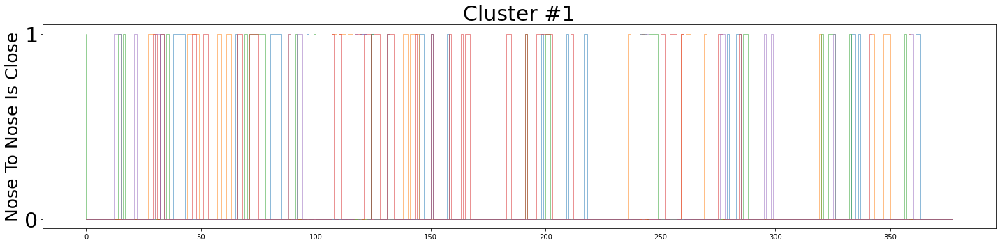

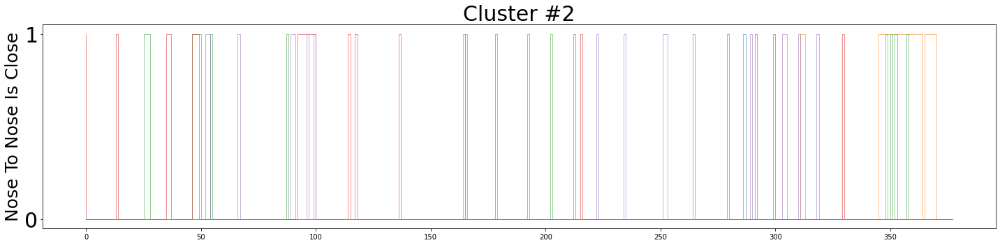

In [47]:
limit = 5
cluster_idx = 1

for label, video_indices in video_mapping.items():
    count = 0
    
    plt.subplots(figsize=(20, 5))
    
    for i in video_indices:
        plt.step(range(X.shape[1]), X[i, :, 0], linewidth=0.5)
        count += 1
        
        if count >= limit:
            break
        
    plt.title(f"Cluster #{cluster_idx}", fontsize=30)
    plt.yticks([0, 1], fontsize=30)
    plt.ylabel('Nose To Nose Is Close', fontsize=25)
    plt.tight_layout()
    plt.show()
    
    cluster_idx += 1

In [ ]:
def compare(a, b):
    if a > b:
        return 1
    elif a < b:
        return -1
    
    return None

def video_name_sort(a, b):
    regex = r'\d+'
    a_nums, b_nums = re.findall(regex, a), re.findall(regex, b)
    
    for i, j in zip(a_nums, b_nums):
        if int(i) > int(j):
            return 1
        if int(i) < int(j):
            return -1
        
    return 0
        
videos_order = sorted(
    os.listdir(VIDEOS_FOLDER), 
    key=cmp_to_key(video_name_sort)
)

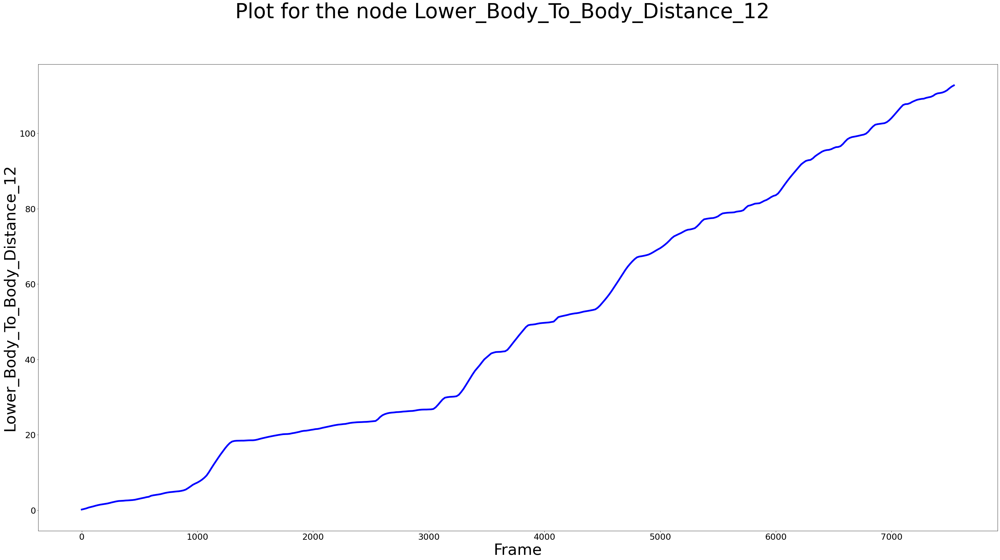

In [8]:
STEP = 20

for row in dataset:
    data = row['Data'][1:]
    data.index = pd.RangeIndex(0, len(data) * STEP, step=STEP)
    
    for node_name in FEATURES_AND_CLUSTER_NUMS.keys():
        data = data[node_name]
        data = data.cumsum()
        
        fig, ax = plt.subplots(figsize=(50, 25), facecolor='white')

        ax.plot(data.index, data, color='blue', linewidth=5)
        ax.set_ylabel(f'{node_name}', fontsize=45)

        ax.tick_params(axis='both', which='major', labelsize=25)
        ax.tick_params(axis='both', which='minor', labelsize=20)

        fig.suptitle(f'Plot for the node {node_name}', fontsize=60)
        plt.xlabel('Frame', fontsize=45)
        plt.show()
        plt.close(fig)
        
        break
    break
            
#         if node_name.endswith('_x'):
#             node_name = node_name[:-2]
#             fig, ax = plt.subplots(2, 1, sharex=True, figsize=(50, 25), facecolor='white')

#             ax[0].plot(data.index, data[f'{node_name}_x'], color='blue', linewidth=5)
#             ax[0].set_ylabel(f'{node_name}_x', fontsize=45)

#             ax[1].plot(data.index, data[f'{node_name}_y'], color='red', linewidth=5)
#             ax[1].set_ylabel(f'{node_name}_y', fontsize=45)
            
#             ax[0].tick_params(axis='both', which='major', labelsize=25)
#             ax[1].tick_params(axis='both', which='major', labelsize=25)
            
#             ax[0].tick_params(axis='both', which='minor', labelsize=20)
#             ax[1].tick_params(axis='both', which='minor', labelsize=20)
#         else:
#             fig, ax = plt.subplots(figsize=(50, 25), facecolor='white')

#             ax.plot(data.index, data[f'{node_name}'], color='blue', linewidth=5)
#             ax.step(data.index, data[f'{node_name[:-12]}_Is_Close'], color='red', linewidth=5)
#             ax.set_ylabel(f'{node_name}', fontsize=45)
            
#             ax.tick_params(axis='both', which='major', labelsize=25)
#             ax.tick_params(axis='both', which='minor', labelsize=20)

#         fig.suptitle(f'Plot for the node {node_name}', fontsize=60)
#         plt.xlabel('Frame', fontsize=45)
#         plt.show()
#         plt.close(fig)

In [4]:
STEP = 20

for row in dataset:
#     data = row['Data'][1:]
    data = row['Data'][1:].cumsum()
    
    data.index = pd.RangeIndex(0, len(data) * STEP, step=STEP)
    
    for node_name in FEATURES_AND_CLUSTER_NUMS.keys():
#         if 'score' in node_name or 'Hand' in node_name or node_name.endswith('_y') or node_name.endswith('_Close'):
        if 'score' in node_name or 'Hand' in node_name or node_name.endswith('_x') or node_name.endswith('_y'):
            continue
            
        graph_folder = os.path.join(GRAPHS_FOLDER, row['Video'].split('.')[0])
        
#         if os.path.exists(f'{graph_folder}/{node_name}.png'):
#             continue

        if os.path.exists(f'{graph_folder}/{node_name}_Cumulative.png'):
            continue
            
        if node_name.endswith('_Is_Close'):
            fig, ax = plt.subplots(figsize=(50, 25), facecolor='white')

            ax.step(data.index, data[f'{node_name}'], color='red', linewidth=5)
            ax.set_ylabel(f'{node_name}', fontsize=45)
            
            ax.tick_params(axis='both', which='major', labelsize=25)
            ax.tick_params(axis='both', which='minor', labelsize=20)
        else:
            fig, ax = plt.subplots(figsize=(50, 25), facecolor='white')

            ax.plot(data.index, data[f'{node_name}'], color='blue', linewidth=5)
            ax.set_ylabel(f'{node_name}', fontsize=45)
            
            ax.tick_params(axis='both', which='major', labelsize=25)
            ax.tick_params(axis='both', which='minor', labelsize=20)
            
#         if node_name.endswith('_x'):
#             node_name = node_name[:-2]
#             fig, ax = plt.subplots(2, 1, sharex=True, figsize=(50, 25), facecolor='white')

#             ax[0].plot(data.index, data[f'{node_name}_x'], color='blue', linewidth=5)
#             ax[0].set_ylabel(f'{node_name}_x', fontsize=45)

#             ax[1].plot(data.index, data[f'{node_name}_y'], color='red', linewidth=5)
#             ax[1].set_ylabel(f'{node_name}_y', fontsize=45)
            
#             ax[0].tick_params(axis='both', which='major', labelsize=25)
#             ax[1].tick_params(axis='both', which='major', labelsize=25)
            
#             ax[0].tick_params(axis='both', which='minor', labelsize=20)
#             ax[1].tick_params(axis='both', which='minor', labelsize=20)
#         else:
#             fig, ax = plt.subplots(figsize=(50, 25), facecolor='white')

#             ax.plot(data.index, data[f'{node_name}'], color='blue', linewidth=5)
#             ax.step(data.index, data[f'{node_name[:-12]}_Is_Close'], color='red', linewidth=5)
#             ax.set_ylabel(f'{node_name}', fontsize=45)
            
#             ax.tick_params(axis='both', which='major', labelsize=25)
#             ax.tick_params(axis='both', which='minor', labelsize=20)

#         fig.suptitle(f'Plot for the node {node_name}', fontsize=60)
        fig.suptitle(f'Plot for cumulative sum of the node {node_name}', fontsize=60)
        plt.xlabel('Frame', fontsize=45)
        
        if not os.path.exists(graph_folder):
            os.mkdir(graph_folder)
            
#         plt.savefig(f'{graph_folder}/{node_name}.png', facecolor=fig.get_facecolor(), edgecolor='none')
        plt.savefig(f'{graph_folder}/{node_name}_Cumulative.png', facecolor=fig.get_facecolor(), edgecolor='none')
        plt.close(fig)